In [1]:
import sys
from pathlib import Path

# 시각화
import plotly.express as px

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, label_binarize
# from sklearn.pipeline import Pipeline
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix, classification_report, balanced_accuracy_score, roc_auc_score, precision_recall_curve, auc, average_precision_score

sys.path.append(str(Path.cwd().parent))
from utils import DATA_DIR, MODEL_DIR

In [2]:
import platform
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.font_manager as fm

# 한글 폰트 설정
if platform.system() == 'Windows':
    plt.rcParams['font.family'] = 'Malgun Gothic'
elif platform.system() == 'Darwin':  # macOS
    plt.rcParams['font.family'] = 'AppleGothic'
else:  # Linux
    plt.rcParams['font.family'] = 'NanumGothic'

plt.rcParams['axes.unicode_minus'] = False

mpl.rcParams['axes.unicode_minus'] = False
# 폰트 개인 경로에 맞춰서 변경
# FONT_DIR = Path("/path/to/fonts")
# font_path = FONT_DIR / 'FREESENTATION-6SEMIBOLD.ttf'
# prop = fm.FontProperties(fname=font_path)

In [3]:
pandas_kwargs = {
    'parse_dates': ['검정일자'],
    'date_format': '%Y-%m-%d'
}

milk: pd.DataFrame = pd.read_csv(DATA_DIR /'interim' / 'milk.csv', **pandas_kwargs)
milk.head()

,농장아이디,개체번호,검정일자,누적착유일(연계),유지방율,유단백,무지고형분,체세포수,MUN,305일유량,...,농후사료급여량(연계),공태일수,유량,질병군,우유등급,비유최고도달일수_log,건유전마지막유량_log,공태일수_log,출생년도,PF비
0,21133,2.007121e+13,2021-03-18,445,6.60,3.28,8.87,274,11.6,15158.0,...,0.0,619,76169939,0,2등급이하,4.143135,4.330733,6.429719,2007,0.496970
1,21133,2.007121e+13,2021-04-28,486,3.64,3.33,8.91,166,11.0,15158.0,...,0.0,619,76170244,0,1등급,4.143135,4.330733,6.429719,2007,0.914835
2,21133,2.007121e+13,2021-05-20,508,2.61,3.35,9.14,156,10.8,15158.0,...,0.0,619,76170487,0,1등급,4.143135,4.330733,6.429719,2007,1.283525
3,21133,2.007121e+13,2021-06-25,544,3.75,3.49,8.99,307,14.1,15158.0,...,0.0,619,76170734,0,2등급이하,4.143135,4.330733,6.429719,2007,0.930667
4,21133,2.007121e+13,2021-07-07,556,3.68,3.74,9.31,34,16.2,15158.0,...,0.0,619,76170903,0,1등급,4.143135,4.330733,6.429719,2007,1.016304


In [4]:
# bins = [15000000, 60000000]

# # milk['유량구간'] = []

# low_milk = milk[milk['유량'] <= 40000000]
# high_milk = milk[milk['유량'] > 40000000]

In [5]:
df = milk

In [6]:
df.shape

(58441, 40)

In [7]:
df.info() # nan값은 pipeline으로 처리할 예정.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58441 entries, 0 to 58440
Data columns (total 40 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   농장아이디         58441 non-null  int64         
 1   개체번호          58441 non-null  float64       
 2   검정일자          58441 non-null  datetime64[ns]
 3   누적착유일(연계)     58441 non-null  int64         
 4   유지방율          42084 non-null  float64       
 5   유단백           42084 non-null  float64       
 6   무지고형분         42084 non-null  float64       
 7   체세포수          58441 non-null  int64         
 8   MUN           42084 non-null  float64       
 9   305일유량        43678 non-null  float64       
 10  305일유지량       43678 non-null  float64       
 11  305일유단백       43678 non-null  float64       
 12  305일무지고형분     43678 non-null  float64       
 13  성년유량          43678 non-null  float64       
 14  성년유지량         43678 non-null  float64       
 15  성년유단백량        43678 non-null  float6

In [8]:
df.describe()

,농장아이디,개체번호,검정일자,누적착유일(연계),유지방율,유단백,무지고형분,체세포수,MUN,305일유량,...,농후사료비(연계),농후사료급여량(연계),공태일수,유량,질병군,비유최고도달일수_log,건유전마지막유량_log,공태일수_log,출생년도,PF비
count,58441.000000,5.844100e+04,58441,58441.000000,42084.000000,42084.000000,42084.000000,58441.000000,42084.000000,43678.000000,...,58441.000000,58441.000000,58441.000000,5.844100e+04,58441.000000,58440.000000,33724.000000,58441.000000,58441.000000,41919.000000
mean,20934.352663,2.016493e+13,2020-12-23 08:15:58.997963776,202.230643,4.170827,3.313077,8.838642,126.464845,14.392603,10720.070104,...,0.189097,0.261529,124.274516,4.707034e+07,0.001044,4.355995,3.808339,3.464868,2016.334816,0.831584
min,20249.000000,2.007121e+13,2020-01-01 00:00:00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,755.000000,...,0.000000,0.000000,0.000000,1.000000e+00,0.000000,0.000000,0.000000,0.000000,2006.000000,0.217631
25%,20269.000000,2.015121e+13,2020-07-08 00:00:00,76.000000,3.630000,3.080000,8.580000,0.000000,11.900000,9384.000000,...,0.000000,0.000000,0.000000,1.589173e+07,0.000000,3.912023,3.931826,0.000000,2015.000000,0.721709
50%,21137.000000,2.017042e+13,2020-12-21 00:00:00,188.000000,4.140000,3.300000,8.870000,38.000000,13.900000,10650.000000,...,0.000000,0.000000,99.000000,6.066701e+07,0.000000,4.369448,4.077537,4.605170,2017.000000,0.805419
75%,21278.000000,2.018041e+13,2021-06-11 00:00:00,303.000000,4.680000,3.540000,9.150000,111.000000,16.500000,12035.000000,...,0.000000,1.000000,193.000000,7.617652e+07,0.000000,4.875197,4.204693,5.267858,2018.000000,0.895151
max,21876.000000,2.021010e+13,2022-02-04 00:00:00,1101.000000,9.990000,8.900000,13.930000,20484.000000,57.200000,21284.000000,...,1.000000,1.000000,974.000000,9.583738e+07,1.000000,6.643790,6.513230,6.882437,2020.000000,4.837838
std,585.808734,1.935616e+10,NaN,150.494690,0.960408,0.413767,0.709344,381.293975,3.789614,2031.349473,...,0.391589,0.439471,126.059024,3.055409e+07,0.032291,0.819051,1.158737,2.370168,1.880170,0.209850


In [9]:
df['우유등급'] = df['우유등급'].map({
    '1등급': 0,
    '2등급이하': 1
})

In [10]:
features = ['누적착유일(연계)', '전산차비유지속성', '현재산차비유지속성', '비유최고도달일수_log',
'건유전마지막유량_log', '전산차건유전유량', '출생년도', '산차', '농후사료비(연계)',
'농후사료급여량(연계)', '공태일수_log']

target = '우유등급'

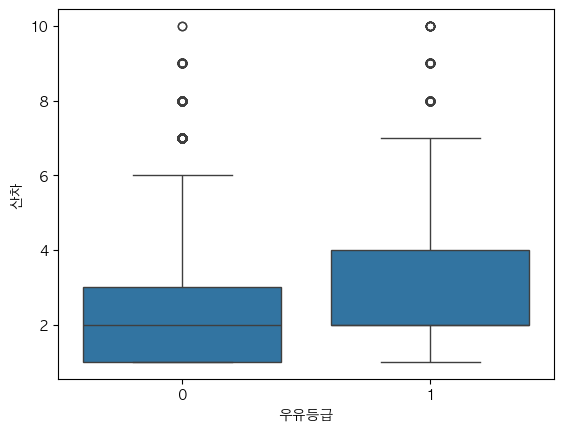

In [11]:
sns.boxplot(df, x=target, y='산차') # 우유등급별로 다른 결측치 처리를 해야겠음.
plt.show()

# 변수들 간의 상관관계 확인해서 상관계수 높은 것들은 제거하거나 처리

In [12]:
vars = features + [target]
corr_matrix = df[vars].corr('spearman').round(3)

fig_corr = px.imshow(
    corr_matrix,
    text_auto=True,
    color_continuous_scale="RdBu_r",
    title="Correlation Matrix (Plotly)",
    template="plotly_dark"
)
fig_corr.update_layout(
    xaxis_title="Features",
    yaxis_title="Features",
    width=1200, height=1000
)
fig_corr.show()



In [13]:
# 농후사료급여량, 산차 살림
features.remove('농후사료비(연계)')
features.remove('출생년도')

features

['누적착유일(연계)',
 '전산차비유지속성',
 '현재산차비유지속성',
 '비유최고도달일수_log',
 '건유전마지막유량_log',
 '전산차건유전유량',
 '산차',
 '농후사료급여량(연계)',
 '공태일수_log']

In [14]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
import pandas as pd

X = df[features].dropna()

vif_data = pd.DataFrame({
    "Feature": features,
    "VIF": [variance_inflation_factor(X, i) for i in range(X.shape[1])]
})

fig_vif = px.bar(
    vif_data.sort_values("VIF", ascending=True),
    x="VIF",
    y="Feature",
    orientation="h",
    title="Variance Inflation Factor (VIF) — 다중공선성 진단",
    template="plotly_dark",
    color="VIF",
    color_continuous_scale="Viridis"
)
fig_vif.add_vline(x=5, line_dash="dash", line_color="orange",
                  annotation_text="주의 경계선 (VIF=5)")
fig_vif.add_vline(x=10, line_dash="dot", line_color="red",
                  annotation_text="심각 (VIF=10)")
fig_vif.show()

In [15]:
# 비유최고도달일수_log 제거
features.remove('비유최고도달일수_log')

# df train/test로 분리해야 함

In [16]:
df[target].value_counts()

우유등급
0    50055
1     8386
Name: count, dtype: int64

In [17]:
df['검정일자'].dt.year.value_counts()

검정일자
2020    30075
2021    28298
2022       68
Name: count, dtype: int64

In [18]:
train = df[df['검정일자'].dt.year == 2020]
test = df[df['검정일자'].dt.year == 2021]

In [19]:
X_train, X_test = train[features], test[features]
y_train, y_test = train['우유등급'], test['우유등급']

# Pipeline 만들고 GridSearchCV 적용해서 best model 찾기!

## LightGBM

In [22]:
import lightgbm as lgb
from imblearn.pipeline import Pipeline
from imblearn.over_sampling import RandomOverSampler
import warnings
warnings.filterwarnings("ignore", category=UserWarning, module="pkg_resources")


## 임시

In [47]:
# Pipeline 구성 (RandomOverSampler + LightGBM)
pipeline = Pipeline([
    ('oversample', RandomOverSampler(sampling_strategy=0.5, random_state=42)),
    ('clf', lgb.LGBMClassifier(
        objective='binary',
        # device='gpu',
        class_weight='balanced',
        random_state=42,
        n_jobs=-1,
        metric='average_precision'
    ))
])

param_grid = {
    'clf__n_estimators': [300, 500, 800],
    'clf__max_depth': [3, 5, 7],
    'clf__learning_rate': [0.01, 0.05],
    'clf__min_child_samples': [3, 5, 7],
    'clf__num_leaves': [15, 31],
    'clf__subsample': [0.7, 0.9]
}

scoring = {
    'f1': 'f1',
    'pr_auc': 'average_precision',
    'recall': 'recall'
}

# GridSearchCV 설정
grid = GridSearchCV(
    pipeline,
    param_grid,
    scoring=scoring,
    refit='pr_auc',
    cv=5,
    n_jobs=-1,
    verbose=2
)

# 학습
grid.fit(X_train, y_train)

Fitting 5 folds for each of 216 candidates, totalling 1080 fits
[LightGBM] [Info] Number of positive: 10557, number of negative: 21114
[LightGBM] [Info] Number of positive: 10557, number of negative: 21114
[LightGBM] [Info] Number of positive: 10557, number of negative: 21114
[LightGBM] [Info] Number of positive: 10557, number of negative: 21114
[LightGBM] [Info] Number of positive: 10557, number of negative: 21114
[LightGBM] [Info] Number of positive: 10557, number of negative: 21115
[LightGBM] [Info] Number of positive: 10557, number of negative: 21114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006936 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1298
[LightGBM] [Info] Number of data points in the train set: 31671, number of used features: 8
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002017 seconds.
You can set `force_row_wise=true` to remove the

,estimator,Pipeline(step...m_state=42))])
,param_grid,"{'clf__learning_rate': [0.01, 0.05], 'clf__max_depth': [3, 5, ...], 'clf__min_child_samples': [3, 5, ...], 'clf__n_estimators': [300, 500, ...], ...}"
,scoring,"{'f1': 'f1', 'pr_auc': 'average_precision', 'recall': 'recall'}"
,n_jobs,-1
,refit,'pr_auc'
,cv,5
,verbose,2
,pre_dispatch,'2*n_jobs'
,error_score,nan
,return_train_score,False
,sampling_strategy,0.5


In [48]:
# 결과 요약
# results = pd.DataFrame(grid.cv_results_)
# print("\nGridSearchCV 결과 요약:")
# print(results)

print("\nBest params (기준: recall):", grid.best_params_)
print("Best recall score:", grid.best_score_)


Best params (기준: recall): {'clf__learning_rate': 0.01, 'clf__max_depth': 3, 'clf__min_child_samples': 7, 'clf__n_estimators': 300, 'clf__num_leaves': 15, 'clf__subsample': 0.7}
Best recall score: 0.19539174385760533


In [49]:
# import joblib
# loaded_best_model = joblib.load('../../models/milk_251106_1059.pkl')
# y_pred = loaded_best_model.predict(X_test)
# y_prob = loaded_best_model.predict_proba(X_test)[:, 1]

In [50]:
# 테스트셋 성능 평가
y_pred = grid.predict(X_test)
y_prob = grid.predict_proba(X_test)[:, 1]

print("\nClassification Report (Test Set):")
print(classification_report(y_test, y_pred, digits=3))

# Balanced Accuracy
bal_acc = balanced_accuracy_score(y_test, y_pred)
print(f"\nBalanced Accuracy (Test Set): {bal_acc:.4f}")

# ROC-AUC
roc = roc_auc_score(y_test, y_prob)
print(f"ROC-AUC(Test Set): {roc:.3f}")

# PR-AUC
avg_precision = average_precision_score(y_test, y_prob)
print(f"PR-AUC(Test Set): {avg_precision:.4f}")


Classification Report (Test Set):
              precision    recall  f1-score   support

           0      0.899     0.491     0.635     23600
           1      0.220     0.724     0.338      4698

    accuracy                          0.529     28298
   macro avg      0.560     0.607     0.486     28298
weighted avg      0.787     0.529     0.586     28298


Balanced Accuracy (Test Set): 0.6072
ROC-AUC(Test Set): 0.646
PR-AUC(Test Set): 0.2525


In [51]:
# Confusion Matrix
cm = pd.DataFrame(confusion_matrix(y_test, y_pred),
                  index=[f"True_{c}" for c in np.unique(y_train)],
                  columns=[f"Pred_{c}" for c in np.unique(y_train)])
print("\nConfusion Matrix (Test Set):")
print(cm)


Confusion Matrix (Test Set):
        Pred_0  Pred_1
True_0   11580   12020
True_1    1298    3400


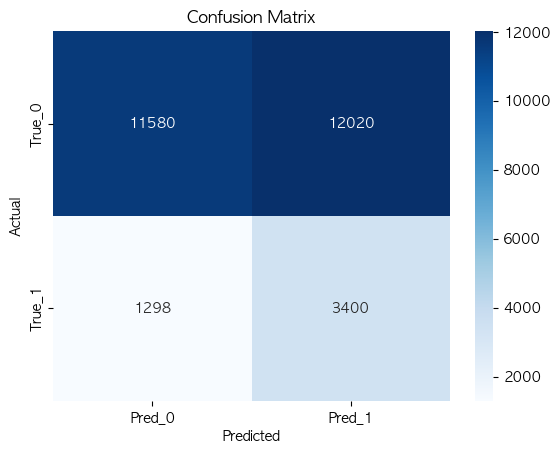

In [52]:
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

In [21]:
from sklearn.metrics import classification_report

y_proba = grid.best_estimator_.predict_proba(X_test)[:, 1]

prec, rec, thresholds = precision_recall_curve(y_test, y_proba)

# NaN 방지
fscore = 2 * (prec * rec) / (prec + rec + 1e-9)
best_idx = np.argmax(fscore)
best_threshold = thresholds[best_idx]

print("✅ Best threshold (max F1):", best_threshold)
print("✅ Best F1:", fscore[best_idx])

y_pred_adj = (y_proba >= best_threshold).astype(int)
print(classification_report(y_test, y_pred_adj))
print("PR-AUC:", average_precision_score(y_test, y_proba))


NameError: name 'grid' is not defined

In [ ]:
# import joblib

# best_model = grid.best_estimator_
# joblib.dump(best_model, '../../models/milk_251107_1208.pkl')

# 나중에 불러오기
# loaded_best_model = joblib.load('lgbm_best_model.pkl')

['../../models/milk_251107_1208.pkl']

# pr auc 상승을 위한 세부 조정

In [85]:
from sklearn.model_selection import train_test_split
X_train2, X_valid, y_train2, y_valid = train_test_split(X_train, y_train, test_size=0.2, stratify=y_train, random_state=42)

In [109]:
from imblearn.pipeline import Pipeline 
from imblearn.over_sampling import RandomOverSampler
import lightgbm as lgb

pipeline = Pipeline([
    ('oversample', RandomOverSampler(sampling_strategy=0.5, random_state=42)),
    ('clf', lgb.LGBMClassifier(
        objective='binary',
        class_weight='balanced',
        random_state=42,
        n_jobs=-1,
        metric='average_precision',
        n_estimators=10000,
        max_depth=9,
        learning_rate=0.03,
        min_child_samples=5,
        min_child_weight=0.01,
        num_leaves=62,
        colsample_bytree= 0.80,
        reg_alpha=0.32,
        reg_lambda=0.09,
        subsample=0.9
    ))
])


# 🔹 학습
pipeline.fit(X_train2, y_train2,
    clf__eval_set=[(X_valid, y_valid)],
    clf__eval_metric='average_precision',
    clf__callbacks=[lgb.early_stopping(stopping_rounds=100, verbose=True)]
)

[LightGBM] [Info] Number of positive: 10557, number of negative: 21114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000417 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1306
[LightGBM] [Info] Number of data points in the train set: 31671, number of used features: 8
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
Training until validation scores don't improve for 100 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

,steps,"[('oversample', ...), ('clf', ...)]"
,transform_input,None
,memory,None
,verbose,False
,sampling_strategy,0.5
,random_state,42
,shrinkage,None
,boosting_type,'gbdt'
,num_leaves,62
,max_depth,9
,learning_rate,0.03


In [111]:
# 테스트셋 성능 평가
y_pred = pipeline.predict(X_test)
y_prob = pipeline.predict_proba(X_test)[:, 1]

print("\nClassification Report (Test Set):")
print(classification_report(y_test, y_pred, digits=3))

# Balanced Accuracy
bal_acc = balanced_accuracy_score(y_test, y_pred)
print(f"\nBalanced Accuracy (Test Set): {bal_acc:.4f}")

# ROC-AUC
roc = roc_auc_score(y_test, y_prob)
print(f"ROC-AUC(Test Set): {roc:.3f}")

# PR-AUC
avg_precision = average_precision_score(y_test, y_prob)
print(f"PR-AUC(Test Set): {avg_precision:.4f}")


Classification Report (Test Set):
              precision    recall  f1-score   support

           0      0.865     0.804     0.833     23600
           1      0.274     0.371     0.315      4698

    accuracy                          0.732     28298
   macro avg      0.569     0.588     0.574     28298
weighted avg      0.767     0.732     0.747     28298


Balanced Accuracy (Test Set): 0.5876
ROC-AUC(Test Set): 0.628
PR-AUC(Test Set): 0.2690


In [ ]:
# import joblib

# best_model = pipeline
# joblib.dump(best_model, '../../models/milk_251107_0205.pkl')

# 나중에 불러오기
# loaded_best_model = joblib.load('lgbm_best_model.pkl')

['../../models/milk_251107_0205.pkl']

# RandomizedSearchCV

In [ ]:
from scipy.stats import randint, uniform
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import make_scorer

pipeline = Pipeline([
    ('oversample', RandomOverSampler(sampling_strategy=0.5, random_state=42)),
    ('clf', lgb.LGBMClassifier(
        objective='binary',
        # device='gpu',
        class_weight='balanced',
        random_state=42,
        n_jobs=-1,
        metric='average_precision'
    ))
])

param_distributions = {
    'clf__n_estimators': randint(300, 1000),
    'clf__learning_rate': uniform(0.01, 0.09),
    'clf__max_depth': randint(5, 11),
    'clf__num_leaves': randint(31, 63),
    'clf__min_child_samples': randint(3, 9),
    'clf__subsample': uniform(0.7, 0.3),
    'clf__colsample_bytree': uniform(0.6, 0.4),
    'clf__min_child_weight': [1e-5, 1e-4, 1e-3, 1e-2],
    'clf__reg_alpha': uniform(0, 0.5),
    'clf__reg_lambda': uniform(0, 0.5),
}

n_iter = 50
cv = 5

scoring = make_scorer(average_precision_score)

lgbm_random = RandomizedSearchCV(
    estimator=pipeline,
    param_distributions=param_distributions,
    n_iter=n_iter,
    cv=cv,
    scoring=scoring,
    refit=True,
    verbose=3,
    random_state=42,
    n_jobs=-1,
)

lgbm_random.fit(
    X_train,
    y_train,
    clf__eval_set=[(X_valid, y_valid)],
    clf__eval_metric='average_precision',
    clf__callbacks=[lgb.early_stopping(stopping_rounds=100, verbose=True)]
)

Fitting 5 folds for each of 50 candidates, totalling 250 fits
[LightGBM] [Info] Number of positive: 10557, number of negative: 21114
[LightGBM] [Info] Number of positive: 10557, number of negative: 21114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005650 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1262
[LightGBM] [Info] Number of positive: 10557, number of negative: 21114
[LightGBM] [Info] Number of data points in the train set: 31671, number of used features: 8
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004101 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1294
[LightGBM] [Info] Number of data points in the train set: 31671, number of used features: 8
[LightGBM] [Info] Number of positive: 10557, number of negative: 21115
[LightGBM] [In

,estimator,Pipeline(step...m_state=42))])
,param_distributions,"{'clf__colsample_bytree': <scipy.stats....t 0x14566a650>, 'clf__learning_rate': <scipy.stats....t 0x14566b100>, 'clf__max_depth': <scipy.stats....t 0x145669810>, 'clf__min_child_samples': <scipy.stats....t 0x14566b9d0>, ...}"
,n_iter,50
,scoring,make_scorer(a...hod='predict')
,n_jobs,-1
,refit,True
,cv,5
,verbose,3
,pre_dispatch,'2*n_jobs'
,random_state,42
,error_score,nan


In [106]:
print("Best params:", lgbm_random.best_params_)
print("Best PR AUC:", lgbm_random.best_score_)
print("Best iteration:", lgbm_random.best_estimator_.named_steps['clf'].best_iteration_)

Best params: {'clf__colsample_bytree': np.float64(0.7970070775275455), 'clf__learning_rate': np.float64(0.027571868901824004), 'clf__max_depth': 9, 'clf__min_child_samples': 5, 'clf__min_child_weight': 0.01, 'clf__n_estimators': 846, 'clf__num_leaves': 62, 'clf__reg_alpha': np.float64(0.3227361479535839), 'clf__reg_lambda': np.float64(0.08855533970352447), 'clf__subsample': np.float64(0.9821375753058743)}
Best PR AUC: 0.12458846894555972
Best iteration: 846


In [112]:
# 테스트셋 성능 평가
y_pred = lgbm_random.predict(X_test)
y_prob = lgbm_random.predict_proba(X_test)[:, 1]

print("\nClassification Report (Test Set):")
print(classification_report(y_test, y_pred, digits=3))

# Balanced Accuracy
bal_acc = balanced_accuracy_score(y_test, y_pred)
print(f"\nBalanced Accuracy (Test Set): {bal_acc:.4f}")

# ROC-AUC
roc = roc_auc_score(y_test, y_prob)
print(f"ROC-AUC(Test Set): {roc:.3f}")

# PR-AUC
avg_precision = average_precision_score(y_test, y_prob)
print(f"PR-AUC(Test Set): {avg_precision:.4f}")


Classification Report (Test Set):
              precision    recall  f1-score   support

           0      0.871     0.799     0.833     23600
           1      0.287     0.406     0.336      4698

    accuracy                          0.734     28298
   macro avg      0.579     0.602     0.585     28298
weighted avg      0.774     0.734     0.751     28298


Balanced Accuracy (Test Set): 0.6025
ROC-AUC(Test Set): 0.640
PR-AUC(Test Set): 0.2824


In [ ]:
# import joblib

# best_model = lgbm_random
# joblib.dump(best_model, '../../models/milk_251107_0254.pkl')

['../../models/milk_251107_0254.pkl']